# ΕΙΣΑΓΩΓΗ

Σέ αυτήν την εργαστηριακή άσκηση θα εξασκηθούμε στην ανάγνωσή και επεξεργασία εικόνων. Συγκεκριμένα, θα μάθουμε να διαβάζουμε εικόνες και να εφαρμόζουμε φίλτρα προσθήκης θορύβου και φίλτρα εξομάλυνσης. Τέλος, θα αξιολογήσουμε την ομοιότητα μεταξύ των αριθμών 3, 5, 8, 9 στο πεδίο του χώρου και του χρόνου. 


Αποφάσισα να υλοποιήσω 4 φίλτρα ταξινομητών τα οποία είναι τα παρακάτω:

    1. Averaging-cv2.blur() 
    2. Gaussian Filtering-cv2.GaussianBlur() 
    3. Median Filtering –cv2.medianBlur()
    4. Bilateral Filtering -cv2.bilateralFilter()
 
    
Θα μετραμε την ομοιότητα της νέας εικόνας με την πρωτότυπη, χρησιμοποιώντας 3 διαφορετικές μετρικές απόδοσης:


    1. Structural Similarity Index 
    2. Mean Squared Error 
    3. Peak signal to noise ratio 

## ΕΡΩΤΗΜΑ 1

Εισαγωγή των απαραίτητων βιβλιοθηκών.

In [1]:
#required packages
import cv2
import numpy as np
import random
import time
import random, os
import pandas as pd
import skimage.measure
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

Φτιάχνουμε ένα Dataframe με τις κατάλληλες στήλες για να αποθηκεύσουμε τα αποτελέσματα.

In [2]:
columns = ['FilterName', 'Structural Similarity Index',
           'Mean Squared Error', 'Peak signal to noise ratio' ]
pd.options.display.float_format = '{:,.2f}'.format
results_DF = pd.DataFrame(columns=columns)

Φτιάχνουμε την παρακάτω συνάρτηση για να προσθέτουμε θόρυβο(salt & paper) σε μια εικόνα. 

In [3]:
#define function to create some noise to an image
def sp_noise(image,prob):
    '''
    Add salt and pepper noise to image. Replaces random pixels with 0 or 1.
    prob: Probability of the noise
    '''
    output = np.zeros(image.shape,np.uint8)
    thres = 1 - prob
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            rdn = random.random()
            if rdn < prob:
                output[i][j] = 0
            elif rdn > thres:
                output[i][j] = 255
            else:
                output[i][j] = image[i][j]
    return output

Φτιάχνουμε την παρακάτω συνάρτηση για να προσθέτουμε θόρυβο (gaussian) σε μια εικόνα. 

In [4]:
def add_gaussian_noise(image):
    row,col,ch= image.shape
    mean = 0
    var = 0.1
    sigma = var**0.5
    gauss = np.random.normal(mean,sigma,(row,col,ch))
    gauss = gauss.reshape(row,col,ch)
    noisy = image + gauss
    return noisy
  

Μετράμε για κάθε συνδυασμό την ομοιότητα τους και ενημερώνουμε το dataframe.

In [5]:
def CalculateScores (filter_name, blur):
    #illustrate the results
    cv2.namedWindow(filter_name, cv2.WINDOW_NORMAL) # this allows for resizing using mouse
    cv2.imshow(filter_name, blur )
    cv2.resizeWindow(filter_name, 480, 360)

    #calculate the similarity between the images
    blur_GRAY = cv2.cvtColor(blur, cv2.COLOR_BGR2GRAY)
    # compute the Structural Similarity Index (SSIM) between the two images
    (score, _) = skimage.measure.compare_ssim(img_GRAY, blur_GRAY, full=True)
    # compute the Mean Squared Error between the two images
    MSE_score = skimage.measure.compare_mse(img_GRAY, blur_GRAY)
    # Compute the peak signal to noise ratio (PSNR) for an image.
    psnr_score = skimage.measure.compare_psnr(img_GRAY, blur_GRAY)
    
    results_DF.loc[len(results_DF)] = [filter_name] + [score] + [MSE_score] + [psnr_score]
    cv2.waitKey()

Διαβάζουμε μια τυχαία εικόνα από τον φάκελο "images to use".

In [6]:
#load a random image
path = r"C:\Users\Christos\Jupyter\Vision\Ask1\lab\Images to use"
random_filename = random.choice([
    x for x in os.listdir(path)
    if os.path.isfile(os.path.join(path, x))
])
print(random_filename)

OnePieceEnd.jpg


In [7]:
#load the image
img_BGR = cv2.imread(path + '\\' + random_filename)
img_GRAY = cv2.cvtColor(img_BGR, cv2.COLOR_BGR2GRAY)

Αρχικοποιούμε τα φίλτρα.

In [8]:
#a. averaging filter
kernel = np.ones((5,5),np.float32)/25 #averaging kernel for 5 x 5 window patch
blur_AF = cv2.filter2D(img_BGR, -1, kernel)

#b. gaussian filter
blur_GF = cv2.GaussianBlur(img_BGR, (5,5), 0)

#c. bilateral filter
blur_BF = cv2.bilateralFilter(img_BGR, 9, 5, 5)


Εφαρμόζουμε τα παραπάνω φίλτρα.

In [9]:
#pess space to continue 

CalculateScores("Averaging Filter", blur_AF)
CalculateScores("Gauss blur Filter", blur_GF)
CalculateScores("Bilateral Filter", blur_BF)

#distroy specific filter windows
cv2.destroyWindow("Averaging Filter")
cv2.destroyWindow("Gauss blur Filter")
cv2.destroyWindow("Bilateral Filter")

cv2.destroyAllWindows()

Παρουσιάζουμε τα αποτελέσματα:

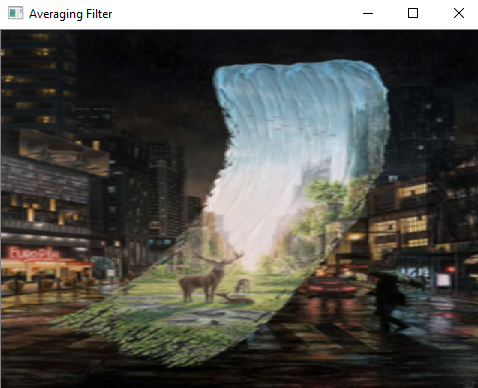

In [10]:
from IPython.display import Image
Image(filename='Output\erwtima1\AveragingFilter.png') 

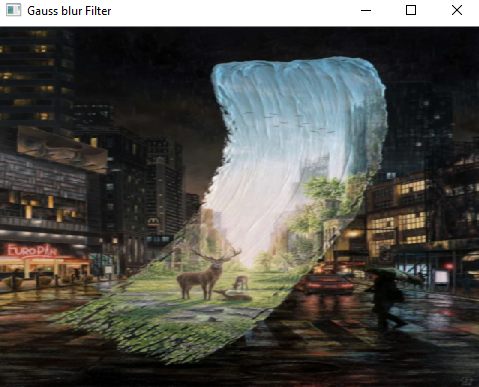

In [11]:
Image(filename='Output\erwtima1\GaussBlur.png') 


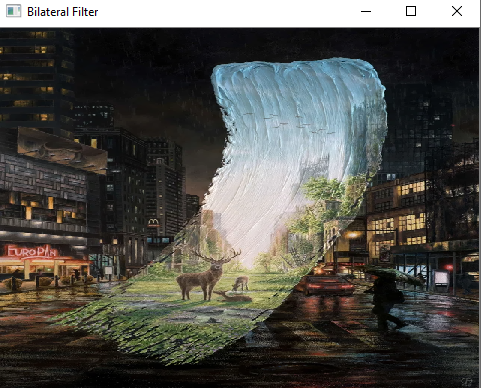

In [12]:
Image(filename=r'Output\erwtima1\bilateral.png') 

Όσο μικρότερη είναι η μετρική MSE τόσο μεγαλύτερη είναι η ομοιότητα μεταξυ των δυο εικόνων. Αν το mse είναι 0 σημαίνει ότι οι δυο εικόνες είναι ίδιες. 

Από την άλλη όσο μεγαλύτερη είναι η μετρική  SSΙ τόσο μεγαλύτερη είναι η ομοιότητα ανάμεσα στις δυο εικόνες. Αν η SSI είναι 1 τότε οι δυο εικόνες είναι ίδιες.

Όσο μεγαλύτερο είναι το PSNR τόσο  μεγαλύτερη είναι η ομοιότητα μεταξύ των δυο εικόνων.

In [13]:
results_DF

,FilterName,Structural Similarity Index,Mean Squared Error,Peak signal to noise ratio
0,Averaging Filter,0.76,375.99,22.38
1,Gauss blur Filter,0.86,208.39,24.94
2,Bilateral Filter,1.00,0.27,53.84




Σε αυτό το σημείο θα πρέπει να ομαδοποιήσουμε τις παραπάνω ενέργειες ώστε να  μπορούν να γίνονται για όλες τις εικόνες που βρίσκονται σε ένα φάκελο.
Επίσης αυτήν την φορά θα προσθέσουμε θόρυβο και με την συνάρτηση **add_gaussian_noise** . 

Φτιάχνουμε ένα νέο Dataframe με τις κατάλληλες στήλες για να αποθηκεύσουμε τα αποτελέσματα.

In [14]:
columns = ['Image ID', ' Noise type',
           ' FilterName', 'Structural Similarity Index',
           'Mean Squared Error', 'Peak signal to noise ratio' ]
results_DF2 = pd.DataFrame(columns=columns)

Αλλάζουμε την CalculateScores ώστε να μπορεί να ενημερώνει το νέο DataFrame.

In [15]:
def CalculateScores2 (img, noise_type, filter_name, blur):
    #illustrate the results
    cv2.namedWindow(filter_name, cv2.WINDOW_NORMAL) # this allows for resizing using mouse
    cv2.imshow(filter_name, blur )
    cv2.resizeWindow(filter_name, 480, 360)

    (score, _) = skimage.measure.compare_ssim(img_GRAY, blur, full=True)
    # compute the Mean Squared Error between the two images
    MSE_score = skimage.measure.compare_mse(img_GRAY, blur)
    # Compute the peak signal to noise ratio (PSNR) for an image.
    psnr_score = skimage.measure.compare_psnr(img_GRAY, blur)
    
    
    results_DF2.loc[len(results_DF2)] = [img] + [noise_type] + [filter_name] + [score] + [MSE_score] + [psnr_score] 
    cv2.waitKey()

Διαβάζουμε όλες τις εικόνες που βρίσκονται στο path.

In [16]:
Images = ( [
    x for x in os.listdir(path)
    if os.path.isfile(os.path.join(path, x))
])
print(Images)

['1280.jpg', 'city.jpg', 'OnePieceEnd.jpg', 'TestImage.jpg']


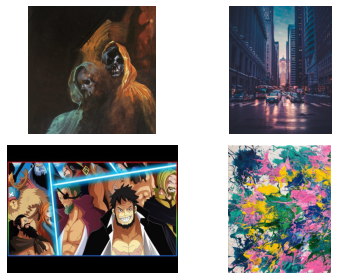

In [17]:
#plot the images
import matplotlib.image as mpimg 
ROW = 2
COLUMN = 2
for i in range(len(Images)):
    image = mpimg.imread(path + '\\' + Images[i]) 
    plt.subplot(ROW, COLUMN, i+1)
    plt.imshow(image)  
    plt.axis('off')  # do not show axis value
plt.tight_layout()   # automatic padding between subplots
plt.show()

Εφαρμόζουμε θόρυβο μια με τεχνική salt&paper και μια με την τεχνική του Gauss και παίρνουμε τα αποτελέσματα για τον κάθε συνδυασμό.

In [18]:
import os 
 

for img in Images:
    #load the images
    img_BGR = cv2.imread(path + '\\' + img)
    img_GRAY = cv2.cvtColor(img_BGR, cv2.COLOR_BGR2GRAY)
    
    #create the new noisy image using salt and peper
    img_NOISY_BGR = sp_noise(img_BGR, 0.13)
    img_NOISY_GRAY = cv2.cvtColor(img_NOISY_BGR, cv2.COLOR_BGR2GRAY)
    
    #create the new noisy image using gaussian_noise
    img_NOISY_BGR_gaus = add_gaussian_noise(img_BGR)
    img_NOISY_GRAY_gaus = cv2.cvtColor(img_NOISY_BGR, cv2.COLOR_BGR2GRAY)
    
    #and illustrate the results
    ##salt and peper
    cv2.namedWindow("Original (noisy) Image", cv2.WINDOW_NORMAL) # this allows for resizing using mouse
    cv2.imshow("Original (noisy) Image", img_NOISY_BGR)
    cv2.resizeWindow("Original (noisy) Image", 480, 360)
    
    
    cv2.namedWindow("Grayscale Original (noisy) Image", cv2.WINDOW_NORMAL) # this allows for resizing using mouse
    cv2.imshow("Grayscale Original (noisy) Image", img_NOISY_GRAY)
    cv2.resizeWindow("Grayscale Original (noisy) Image", 480, 360) 
    
    cv2.waitKey()
    
    cv2.destroyWindow("Grayscale Original (noisy) Image")
    
    
    
    #step 2 apply some filters and compare change to the original
    
    # averaging filter
    kernel = np.ones((5,5),np.float32)/25 #averaging kernel for 5 x 5 window patch
    blur_AF = cv2.filter2D(img_NOISY_GRAY, -1, kernel)
    
    #b. gaussian filter
    blur_GF = cv2.GaussianBlur(img_NOISY_GRAY, (5,5), 0)

    #c. bilateral filter
    blur_BF = cv2.bilateralFilter(img_NOISY_GRAY, 9, 5, 5)
    
    ####GAUSSIAN
    # averaging filter
    blur_AF_gaus = cv2.filter2D(img_NOISY_GRAY_gaus, -1, kernel)
    
    #b. gaussian filter
    blur_GF_gaus = cv2.GaussianBlur(img_NOISY_GRAY_gaus, (5,5), 0)

    #c. bilateral filter
    blur_BF_gaus = cv2.bilateralFilter(img_NOISY_GRAY_gaus, 9, 5, 5)
    
    img_NOISY_BGR.shape
    img_NOISY_BGR_gaus.shape
  
    CalculateScores2(img, "s&p", "Averaging Filter", blur_AF)
    CalculateScores2(img, "s&p", "Gauss blur Filter", blur_GF)
    CalculateScores2(img, "s&p", "Bilateral Filter", blur_BF)
    #distroy specific filter windows
    cv2.destroyWindow("Averaging Filter")
    cv2.destroyWindow("Gauss blur Filter")
    cv2.destroyWindow("Bilateral Filter")
    
    CalculateScores2(img, "Gaussian","Averaging Filter(Gaus)", blur_AF_gaus)
    CalculateScores2(img, "Gaussian","Gauss blur Filter(Gaus)", blur_GF_gaus)
    CalculateScores2(img, "Gaussian","Bilateral Filter(Gaus)", blur_BF_gaus)
    
  

    
    cv2.destroyAllWindows()

Εμφανίζουμε τα αποτελέσματα.

In [19]:
from matplotlib import rcParams
%matplotlib inline
def showImages(subfolder):
    rcParams['figure.figsize'] = 100 ,100
    path = r"C:\Users\Christos\Jupyter\Vision\Ask1\lab\Output\erwtima2"
    path = path + '\\' +  subfolder
    Images = ( [
        x for x in os.listdir(path)
        if os.path.isfile(os.path.join(path , x))
    ])
    ROW = 4
    COLUMN = 2
    for i in range(len(Images)):
        image = mpimg.imread(path + '\\' + Images[i]) 
        plt.subplot(ROW, COLUMN, i+1)
        plt.imshow(image)  
        plt.axis('off')  # do not show axis value
    plt.tight_layout()   # automatic padding between subplots
    plt.show()
    

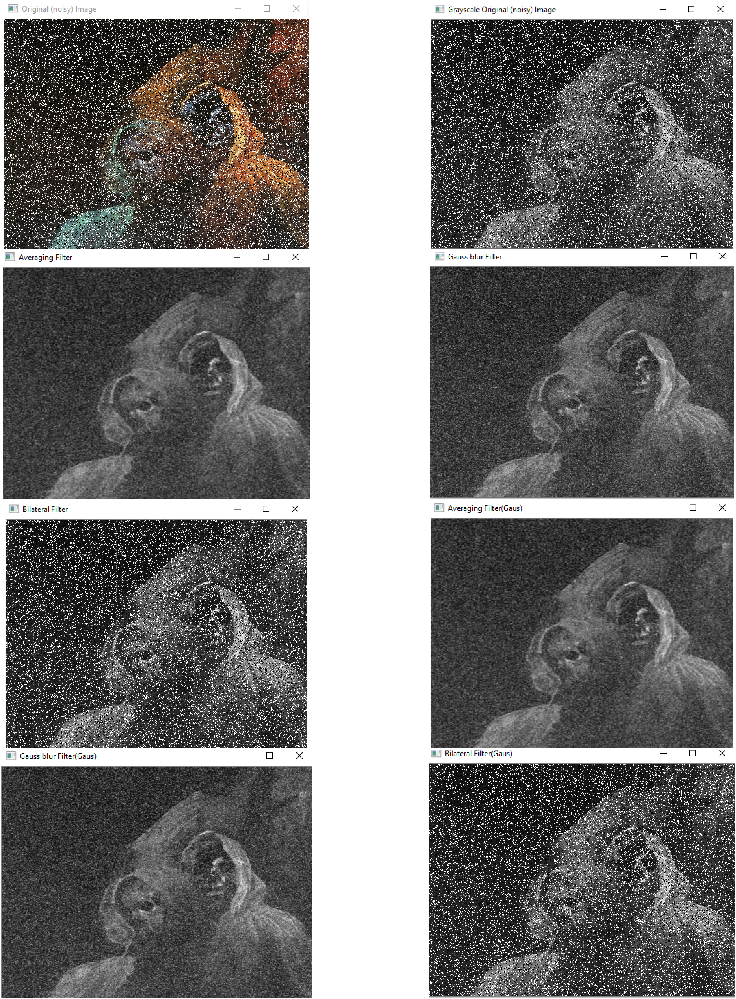

In [20]:
showImages('1280')

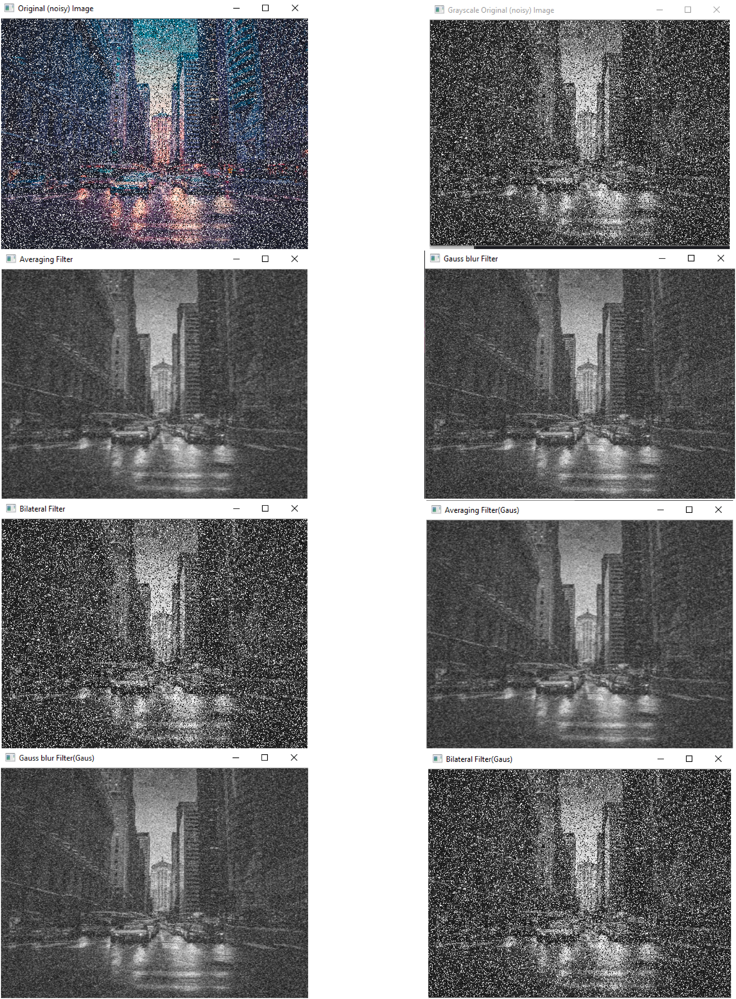

In [21]:
showImages('City')

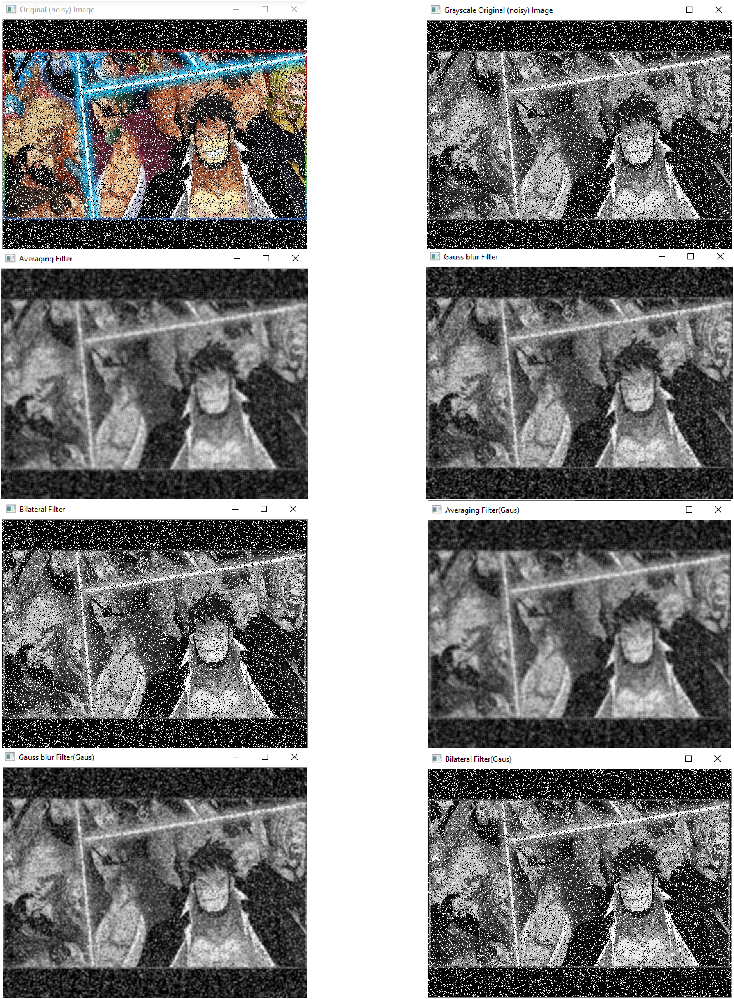

In [22]:
showImages('OnePieceEnd')

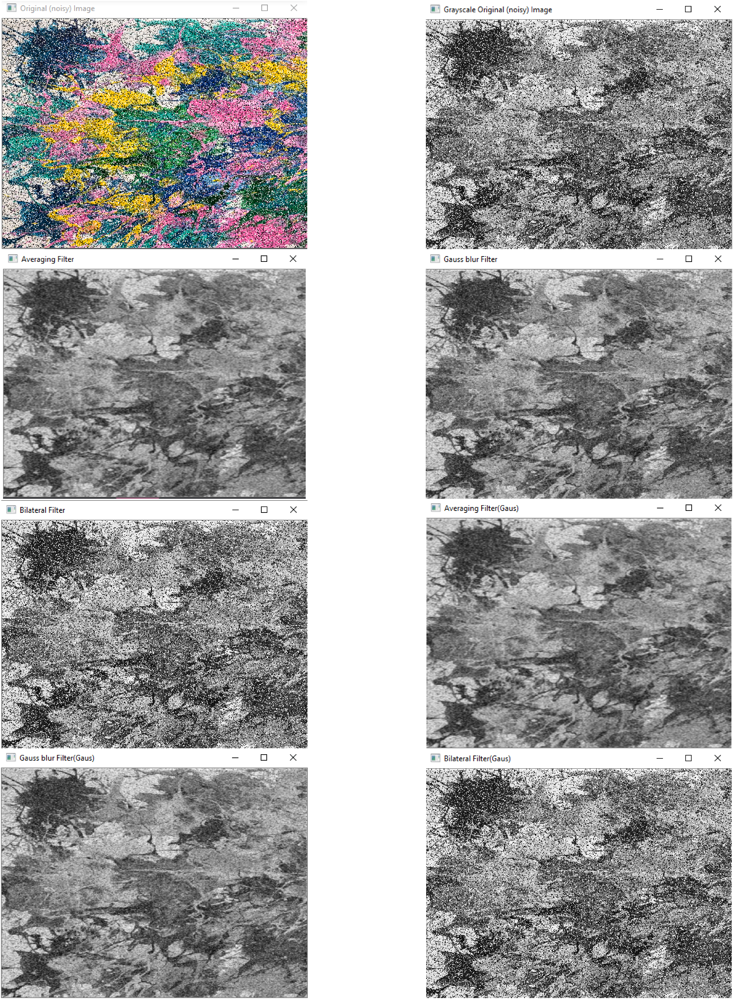

In [23]:
showImages('TestImage')

In [24]:
results_DF2

,Image ID,Noise type,FilterName,Structural Similarity Index,Mean Squared Error,Peak signal to noise ratio
0,1280.jpg,s&p,Averaging Filter,0.30,715.55,19.58
1,1280.jpg,s&p,Gauss blur Filter,0.22,887.42,18.65
2,1280.jpg,s&p,Bilateral Filter,0.03,"5,965.41",10.37
3,1280.jpg,Gaussian,Averaging Filter(Gaus),0.30,715.55,19.58
4,1280.jpg,Gaussian,Gauss blur Filter(Gaus),0.22,887.42,18.65
5,1280.jpg,Gaussian,Bilateral Filter(Gaus),0.03,"5,965.41",10.37
6,city.jpg,s&p,Averaging Filter,0.33,692.60,19.73
7,city.jpg,s&p,Gauss blur Filter,0.27,820.03,18.99
8,city.jpg,s&p,Bilateral Filter,0.06,"5,602.50",10.65
9,city.jpg,Gaussian,Averaging Filter(Gaus),0.33,692.60,19.73
